# EE5176 Programming Assignment 1: White Balancing and Tone Mapping (Built-in Demosaicing)

This notebook implements the White Balancing and Tone Mapping sections using builtin OpenCV demosaicing.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import median_filter
from skimage import color
import cv2
import scipy.io as sio
import warnings
warnings.filterwarnings('ignore')
plt.rcParams['figure.figsize'] = (15, 10)
plt.rcParams['font.size'] = 10


## Load Raw Images and Bayer Patterns
Supports RGGB and GRBG CFA.

NOTE: The blue and red may appear flipped in builtin implementation as compared to the manual one depending on what is saved as the first, second and third  channel,  and plotted. (depends on if it's saved as bgr, or rgb)

In [2]:
def demosaic_builtin(raw_image, cfa_pattern):
    # Normalize and convert to uint8 if necessary for OpenCV
    raw_conv = raw_image.copy()
    if raw_conv.dtype != np.uint8:
        raw_conv = np.clip(raw_conv, 0, 255).astype(np.uint8)
    # Select OpenCV color code based on CFA
    if cfa_pattern == 'RGGB':
        code = cv2.COLOR_BAYER_RG2BGR
    elif cfa_pattern == 'GRBG':
        code = cv2.COLOR_BAYER_GR2BGR
    else:
        raise ValueError(f'Unsupported CFA pattern: {cfa_pattern}')
    # Perform demosaicing using OpenCV builtin
    rgb_img = cv2.cvtColor(raw_conv, code)
    return rgb_img


In [3]:
# Load RAW images and patterns
images_info = {
    'Raw_image1': {
        'raw_file': 'Copy of RawImage1.mat',
        'cfa': 'RGGB'
    },
    'Raw_image2': {
        'raw_file': 'Copy of RawImage2.mat',
        'cfa': 'GRBG'
    },
    'Raw_image3': {
        'raw_file': 'Copy of RawImage3.mat',
        'cfa': 'RGGB'
    }
}
demosaiced_images = {}
bayer_masks = {}

for i in range(1, 4):
    bayer_data = sio.loadmat(f'Copy of bayer{i}.mat')
    bayer_masks[f'Image{i}'] = bayer_data[f'bayer{i}']
    print(f"Bayer mask shape: {bayer_masks[f'Image{i}'].shape}")
    print(f"Bayer mask unique values: {np.unique(bayer_masks[f'Image{i}'])}")

i = 1
for name, info in images_info.items():
    try:
        raw_data = sio.loadmat(info['raw_file'])
        raw_img = raw_data[f'RawImage{i}']
        img_rgb = demosaic_builtin(raw_img, info['cfa'])
        demosaiced_images[name] = img_rgb
        print(f'{name}: Loaded and demosaiced [{info["cfa"]}]')
        i = i + 1
    except Exception as e:
        print(f'Could not load {name}: {e}')
        demosaiced_images[name] = None

Bayer mask shape: (1128, 2048)
Bayer mask unique values: [1 2 3]
Bayer mask shape: (1000, 2000)
Bayer mask unique values: [1 2 3]
Bayer mask shape: (1124, 2028)
Bayer mask unique values: [1 2 3]
Raw_image1: Loaded and demosaiced [RGGB]
Raw_image2: Loaded and demosaiced [GRBG]
Raw_image3: Loaded and demosaiced [RGGB]


In [4]:
print(demosaiced_images.keys())

dict_keys(['Raw_image1', 'Raw_image2', 'Raw_image3'])


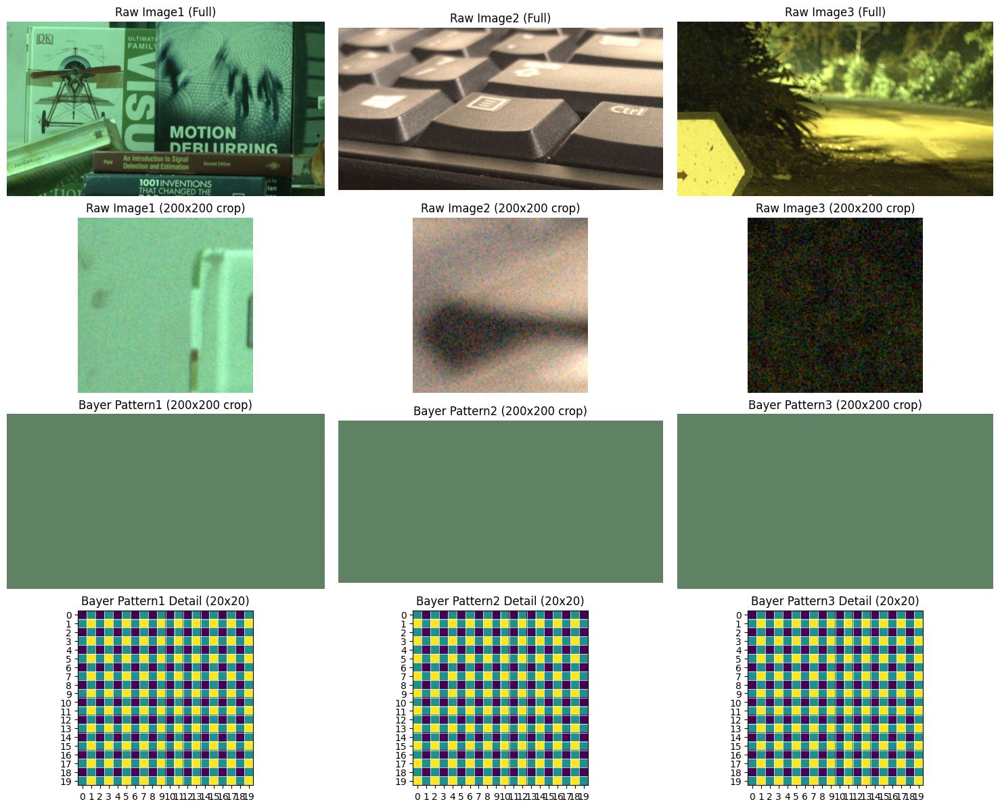

In [5]:
fig, axes = plt.subplots(4, 3, figsize=(15, 12))
crop_size = 200
pattern_crop = 20

# Full color images (no cmap)
axes[0, 0].imshow(demosaiced_images['Raw_image1'])
axes[0, 0].set_title('Raw Image1 (Full)')
axes[0, 0].axis('off')

axes[0, 1].imshow(demosaiced_images['Raw_image2'])
axes[0, 1].set_title('Raw Image2 (Full)')
axes[0, 1].axis('off')

axes[0, 2].imshow(demosaiced_images['Raw_image3'])
axes[0, 2].set_title('Raw Image3 (Full)')
axes[0, 2].axis('off')

# Cropped color images (no cmap)
axes[1, 0].imshow(demosaiced_images['Raw_image1'][:crop_size, :crop_size])
axes[1, 0].set_title(f'Raw Image1 ({crop_size}x{crop_size} crop)')
axes[1, 0].axis('off')

axes[1, 1].imshow(demosaiced_images['Raw_image2'][:crop_size, :crop_size])
axes[1, 1].set_title(f'Raw Image2 ({crop_size}x{crop_size} crop)')
axes[1, 1].axis('off')

axes[1, 2].imshow(demosaiced_images['Raw_image3'][:crop_size, :crop_size])
axes[1, 2].set_title(f'Raw Image3 ({crop_size}x{crop_size} crop)')
axes[1, 2].axis('off')

# Bayer pattern masks with viridis cmap
axes[2, 0].imshow(bayer_masks['Image1'], cmap='viridis')
axes[2, 0].set_title(f'Bayer Pattern1 ({crop_size}x{crop_size} crop)')
axes[2, 0].axis('off')

axes[2, 1].imshow(bayer_masks['Image2'], cmap='viridis')
axes[2, 1].set_title(f'Bayer Pattern2 ({crop_size}x{crop_size} crop)')
axes[2, 1].axis('off')

axes[2, 2].imshow(bayer_masks['Image3'], cmap='viridis')
axes[2, 2].set_title(f'Bayer Pattern3 ({crop_size}x{crop_size} crop)')
axes[2, 2].axis('off')

# Bayer pattern details with grid lines
for col in range(3):
    im = axes[3, col].imshow(bayer_masks[f'Image{col+1}'][:pattern_crop, :pattern_crop],
                            cmap='viridis', interpolation='nearest')
    axes[3, col].set_title(f'Bayer Pattern{col+1} Detail ({pattern_crop}x{pattern_crop})')
    for i in range(pattern_crop + 1):
        axes[3, col].axhline(i - 0.5, color='white', linewidth=0.5)
        axes[3, col].axvline(i - 0.5, color='white', linewidth=0.5)
    axes[3, col].set_xticks(range(pattern_crop))
    axes[3, col].set_yticks(range(pattern_crop))

plt.tight_layout()
plt.show()


## White Balancing Functions

In [6]:
def white_balance_gray_world(image):
    image_float = image.astype(np.float64)
    avg_r = np.mean(image_float[:, :, 0])
    avg_g = np.mean(image_float[:, :, 1])
    avg_b = np.mean(image_float[:, :, 2])
    gray_val = (avg_r + avg_g + avg_b) / 3.0
    scale = [gray_val / avg_r, gray_val / avg_g, gray_val / avg_b]
    for i in range(3):
        image_float[:, :, i] *= scale[i]
    result = np.clip(image_float, 0, 255).astype(np.uint8)
    return result
def white_balance_white_patch(image, pixel_coord):
    image_float = image.astype(np.float64)
    x, y = pixel_coord
    pixel = image_float[y, x]
    max_val = max(pixel)
    scale = [max_val / (p if p > 0 else 1) for p in pixel]
    for i in range(3):
        image_float[:, :, i] *= scale[i]
    result = np.clip(image_float, 0, 255).astype(np.uint8)
    return result
def white_balance_neutral_point(image, pixel_coord):
    image_float = image.astype(np.float64)
    x, y = pixel_coord
    pixel = image_float[y, x]
    neutral_val = np.mean(pixel)
    scale = [neutral_val / (p if p > 0 else 1) for p in pixel]
    for i in range(3):
        image_float[:, :, i] *= scale[i]
    result = np.clip(image_float, 0, 255).astype(np.uint8)
    return result


## Apply White Balancing with Specified Pixel Coordinates

In [7]:
white_patch_coords = {
    'Raw_image1': (830, 814),
    'Raw_image2': (1165, 280),
    'Raw_image3': (175, 675)
}
neutral_point_coords = {
    'Raw_image1': (2000, 435),
    'Raw_image2': (445, 715),
    'Raw_image3': (1550, 565)
}
white_balanced_results = {}
for img_name, img_rgb in demosaiced_images.items():
    if img_rgb is not None:
        wb_gray = white_balance_gray_world(img_rgb)
        wb_white_patch = white_balance_white_patch(img_rgb, white_patch_coords[img_name])
        wb_neutral = white_balance_neutral_point(img_rgb, neutral_point_coords[img_name])
        white_balanced_results[img_name] = {
            'original': img_rgb,
            'gray_world': wb_gray,
            'white_patch': wb_white_patch,
            'neutral_point': wb_neutral
        }


## Tone Mapping (Histogram Equalization 
and Gamma Correction)

In [8]:
def histogram_equalization(image):
    yuv = cv2.cvtColor(image, cv2.COLOR_RGB2YUV)
    yuv[:, :, 0] = cv2.equalizeHist(yuv[:, :, 0])
    result = cv2.cvtColor(yuv, cv2.COLOR_YUV2RGB)
    return result
def gamma_correction(image, gamma):
    norm = image.astype(np.float64) / 255.0
    corrected = np.power(norm, gamma)
    result = (corrected * 255).astype(np.uint8)
    return result
def apply_tone_mapping(image):
    return {
        'original': image,
        'histogram_eq': histogram_equalization(image),
        'gamma_0.5': gamma_correction(image, 0.5),
        'gamma_0.7': gamma_correction(image, 0.7),
        'gamma_0.9': gamma_correction(image, 0.9)
    }


## Apply Tone Mapping to All White Balanced Versions

In [9]:
tone_mapped_results = {}
for img_name, wbs in white_balanced_results.items():
    tone_mapped_results[img_name] = {}
    for method, img in wbs.items():
        tone_mapped_results[img_name][method] = apply_tone_mapping(img)


## Visualization Utilities

In [10]:
def display_white_balance_comparison(img_name, wb_results):
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    fig.suptitle(f'White Balance Comparison - {img_name}', fontsize=16)
    axes[0,0].imshow(wb_results['original'])
    axes[0,0].set_title('Original')
    axes[0,0].axis('off')
    axes[0,1].imshow(wb_results['gray_world'])
    axes[0,1].set_title('Gray World')
    axes[0,1].axis('off')
    axes[1,0].imshow(wb_results['white_patch'])
    axes[1,0].set_title('White Patch')
    axes[1,0].axis('off')
    axes[1,1].imshow(wb_results['neutral_point'])
    axes[1,1].set_title('Neutral Point')
    axes[1,1].axis('off')
    plt.tight_layout()
    plt.show()
def display_tone_mapping_comparison(img_name, wb_method, tone_results):
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    fig.suptitle(f'Tone Mapping Comparison - {img_name} ({wb_method})', fontsize=16)
    axes[0,0].imshow(tone_results['original'])
    axes[0,0].set_title('Original')
    axes[0,0].axis('off')
    axes[0,1].imshow(tone_results['histogram_eq'])
    axes[0,1].set_title('Histogram Equalization')
    axes[0,1].axis('off')
    axes[0,2].imshow(tone_results['gamma_0.5'])
    axes[0,2].set_title('Gamma 0.5')
    axes[0,2].axis('off')
    axes[1,0].imshow(tone_results['gamma_0.7'])
    axes[1,0].set_title('Gamma 0.7')
    axes[1,0].axis('off')
    axes[1,1].imshow(tone_results['gamma_0.9'])
    axes[1,1].set_title('Gamma 0.9')
    axes[1,1].axis('off')
    axes[1,2].axis('off')
    plt.tight_layout()
    plt.show()


## Display Results

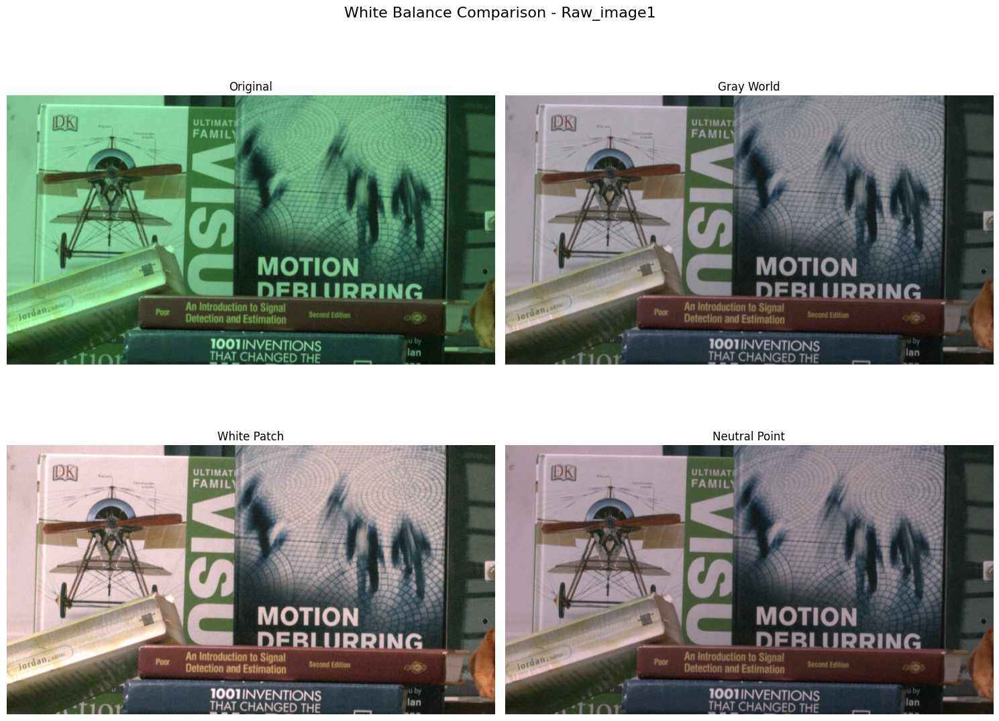

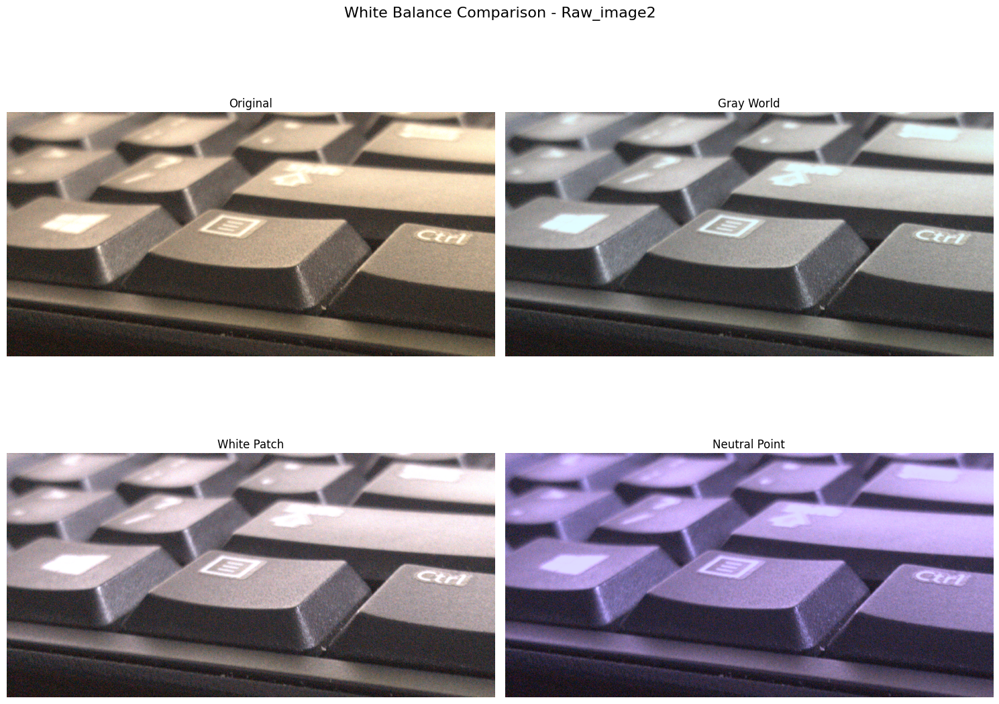

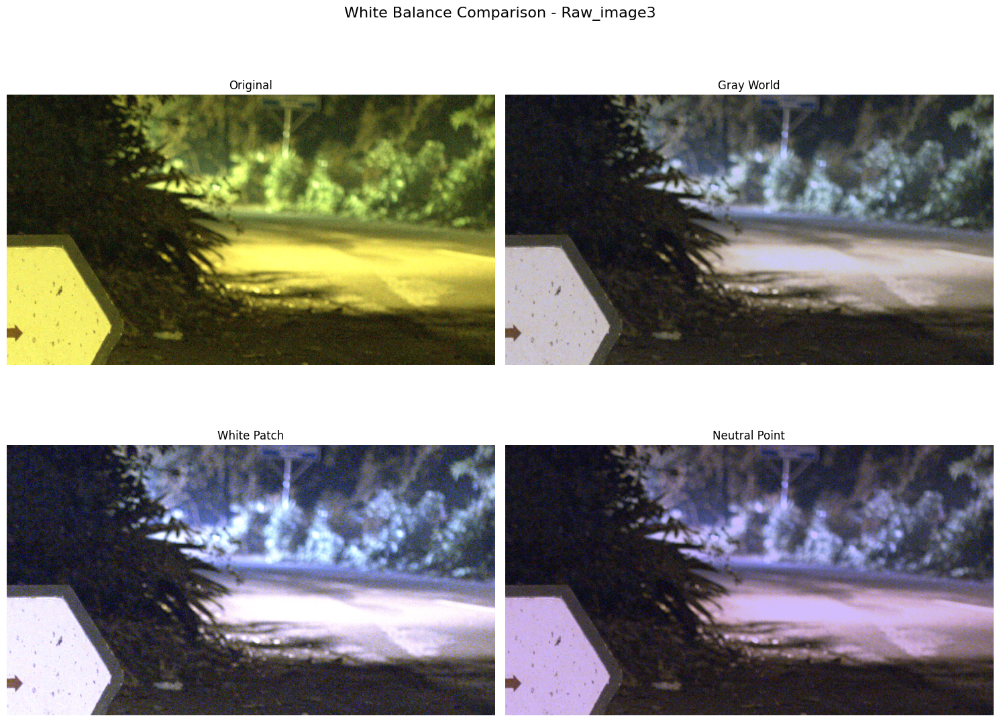

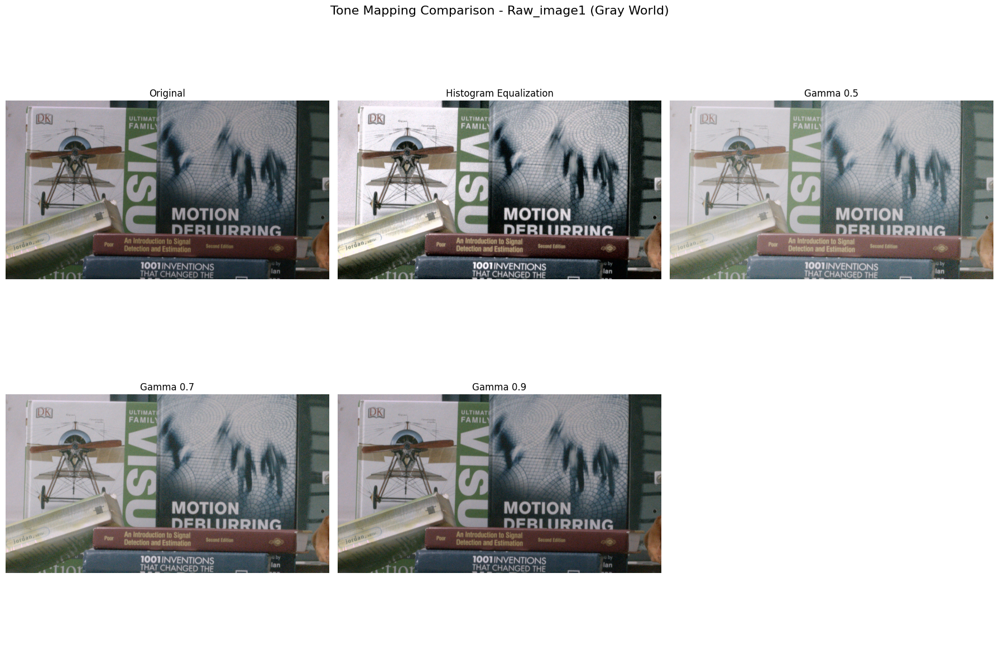

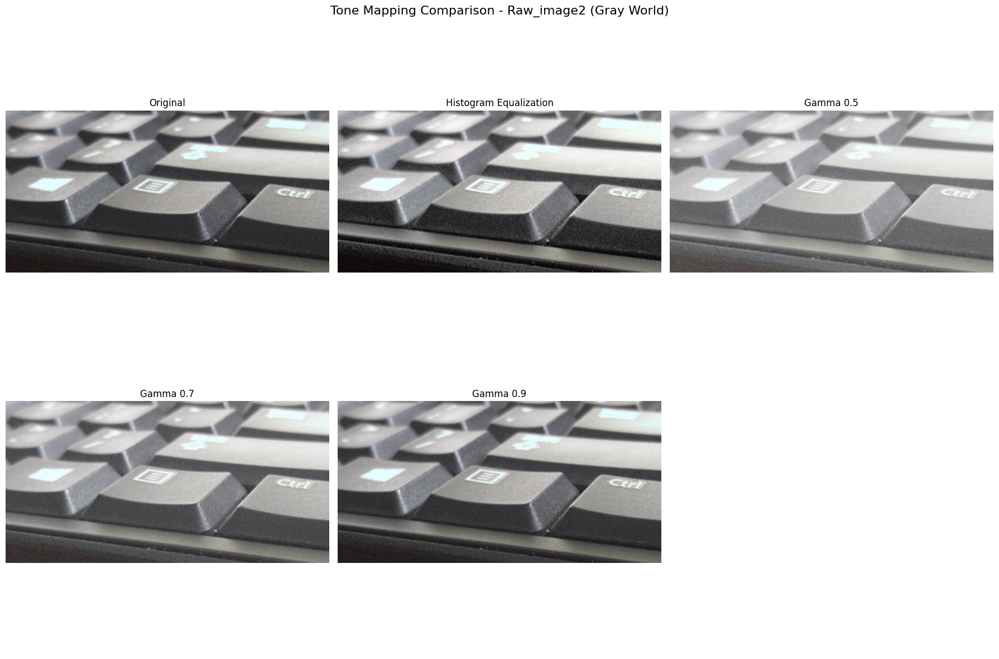

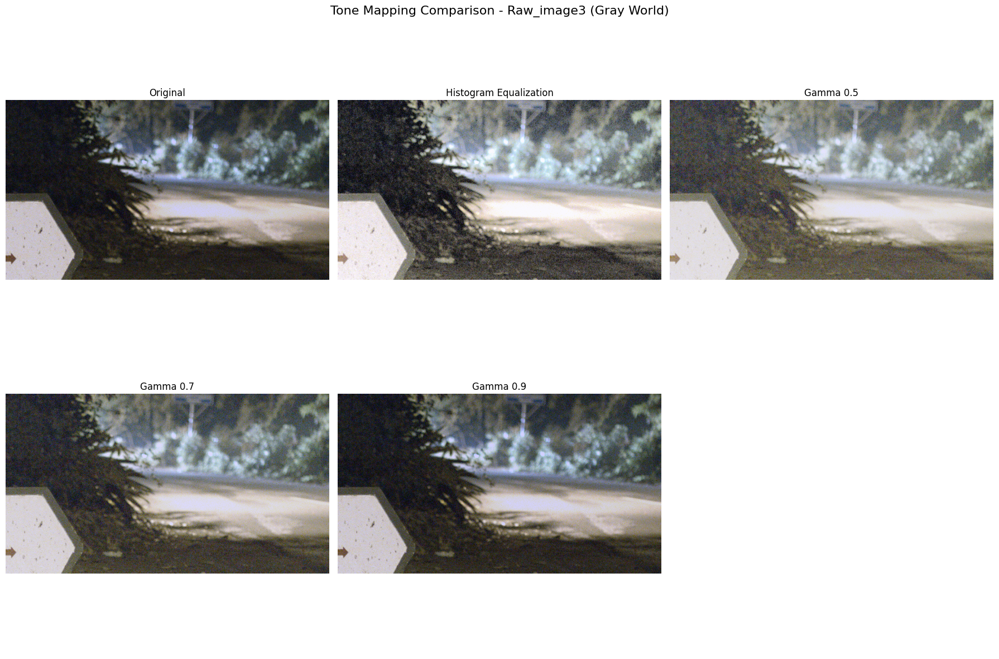

In [11]:
# Display white balance comparisons
for img_name in white_balanced_results.keys():
    display_white_balance_comparison(img_name, white_balanced_results[img_name])
# Display tone mapping for Gray World (can use others similarly)
for img_name in tone_mapped_results.keys():
    display_tone_mapping_comparison(img_name, 'Gray World', tone_mapped_results[img_name]['gray_world'])


## Summary
This notebook runs white balancing (three methods) and tone mapping (histogram equalization, gamma correction) over builtin demosaiced images.